In [141]:
#!pip install pandas
#!pip install plotly
#!pip install seaborn

In [142]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import plotly.express as px

# Importing the datasets
The footpods_updated dataset has been filterd with only the correct running sessions.

In [143]:
df = pd.read_csv('datadump/footpods_updated.csv')
sessions = pd.read_csv('datadump/sessions.csv')

In [145]:
df = df.drop(columns = ['Unnamed: 0', 'Date', 'session_id', 'user_id', 't_start', 't_end', 'duration'])

In [146]:
df.head()

,t,foot,pronation,braking,impact,contact_time,flight_ratio,strike,power
0,2020-10-20 17:41:31.043948174,left,-13.4,3.7500,5.6250,496,-6.625,7,184
1,2020-10-20 17:41:31.410662174,right,-18.2,4.8750,6.6875,508,-12.750,7,280
2,2020-10-20 17:41:31.615272999,left,-13.5,4.5625,7.3125,441,-0.250,7,215
3,2020-10-20 17:41:32.011847019,right,-17.2,6.0000,8.1250,452,-6.000,7,360
4,2020-10-20 17:41:32.453961849,left,-13.5,5.4375,9.1875,392,5.625,7,230


# Calculating time difference between rows
To find out when the test subject is running or not, a filter method has been used by calculating the time difference between data inputs. 

First the column 't' is converted to a datetime instead of a object. Then the difference between rows is calculated in a new row named 'diff'. Only the datetime in seconds is important to the function total_seconds is called. A frequency is calculated by dividing 1 with the time difference. 

There is no time difference for the first row of the dataset, so it is removed. The column diff is dropped.

In [147]:
df['t'] = pd.to_datetime(df['t'])

In [148]:
df['diff'] = df.t.diff()

In [149]:
df['diff_seconds'] = df['diff'].dt.total_seconds()

In [150]:
df['frequency_hz'] = 1 / df['diff_seconds'] 

In [156]:
# Remove the first and only NULL value
df = df.iloc[1: , :]
df = df.drop(columns = 'diff')

In [157]:
df.head()

,t,foot,pronation,braking,impact,contact_time,flight_ratio,strike,power,diff_seconds,frequency_hz
3,2020-10-20 17:41:32.011847019,right,-17.2,6.0000,8.1250,452,-6.000,7,360,0.396574,2.521597
4,2020-10-20 17:41:32.453961849,left,-13.5,5.4375,9.1875,392,5.625,7,230,0.442115,2.261856
5,2020-10-20 17:41:32.852926970,right,-17.2,7.1250,9.4375,418,-4.000,7,415,0.398965,2.506485
6,2020-10-20 17:41:33.023308992,left,-12.8,6.1250,10.6875,354,10.375,7,255,0.170382,5.869164
7,2020-10-20 17:41:33.422121048,right,-17.4,7.6250,10.6875,382,0.250,7,434,0.398812,2.507447


# Removing outliers
Looking if there are any outliers based on the description of the time difference.
Then dropping the outlier that is less then 0.

In [158]:
df['diff_seconds'].describe()

count    2.198750e+05
mean     1.559693e+01
std      1.054555e+05
min     -1.826788e+07
25%      2.800055e-01
50%      3.524570e-01
75%      4.150870e-01
max      2.004701e+07
Name: diff_seconds, dtype: float64

In [159]:
df = df.drop(df[(df['diff_seconds'] < 0)].index)
df['diff_seconds'].describe()

count    2.198650e+05
mean     4.392813e+02
std      7.308355e+04
min      8.822000e-06
25%      2.800131e-01
50%      3.524580e-01
75%      4.150929e-01
max      2.004701e+07
Name: diff_seconds, dtype: float64

In [163]:
df_filth = df.drop(df[(df['diff_seconds'] > 5)].index)
df_filth = df_filth.drop(df_filth[(df_filth['diff_seconds'] < 0)].index)

In [164]:
#['diff_seconds']= df['diff_seconds'].dt.round('10L')

# Visualising the distribution of time difference

In [165]:
fig = px.histogram(data_frame=df_filth,
                  x='diff_seconds')
fig.show()

# Boxplotting the time difference
Boxplotting the time difference, gives a upper fence of 0.62, this information is then used to filter the data more.

In [166]:
fig = px.box(df_filth, y='diff_seconds')
fig.show()

In [167]:
# Dropping the lower and upper values that fallout the boxplot
df_filth = df_filth.drop(df_filth[(df_filth['diff_seconds'] > 0.62)].index)
df_filth = df_filth.drop(df_filth[(df_filth['diff_seconds'] < 0.2)].index)

# Visualizing the results of all footpod data

In [169]:
fig = px.histogram(data_frame=df_filth,
                  x='diff_seconds')
fig.show()

## The amount of rows that have been filterd out!

In [170]:
print("Unfilterd amount of rows: ",df['diff_seconds'].count())
print("Filterd amount of rows:   ",df_filth['diff_seconds'].count())
print("The amount of removed rows:",(df['diff_seconds'].count()) - (df_filth['diff_seconds'].count()))

Unfilterd amount of rows:  219865
Filterd amount of rows:    204108
The amount of removed rows: 15757


# Looking at one session

In [171]:
filth_day1 = df_filth.loc[(df_filth['t'].dt.day==23) & (df_filth['t'].dt.month==12)]

In [172]:
fig = px.histogram(data_frame=filth_day1,
                  x='diff_seconds',
                  nbins= 20)
fig.show()

## Boxplot results of December the 23rd

In [173]:
fig = px.box(filth_day1, y='diff_seconds')
fig.show()

# Correlation plot
- Green = Right foot
- Orange = Left foot

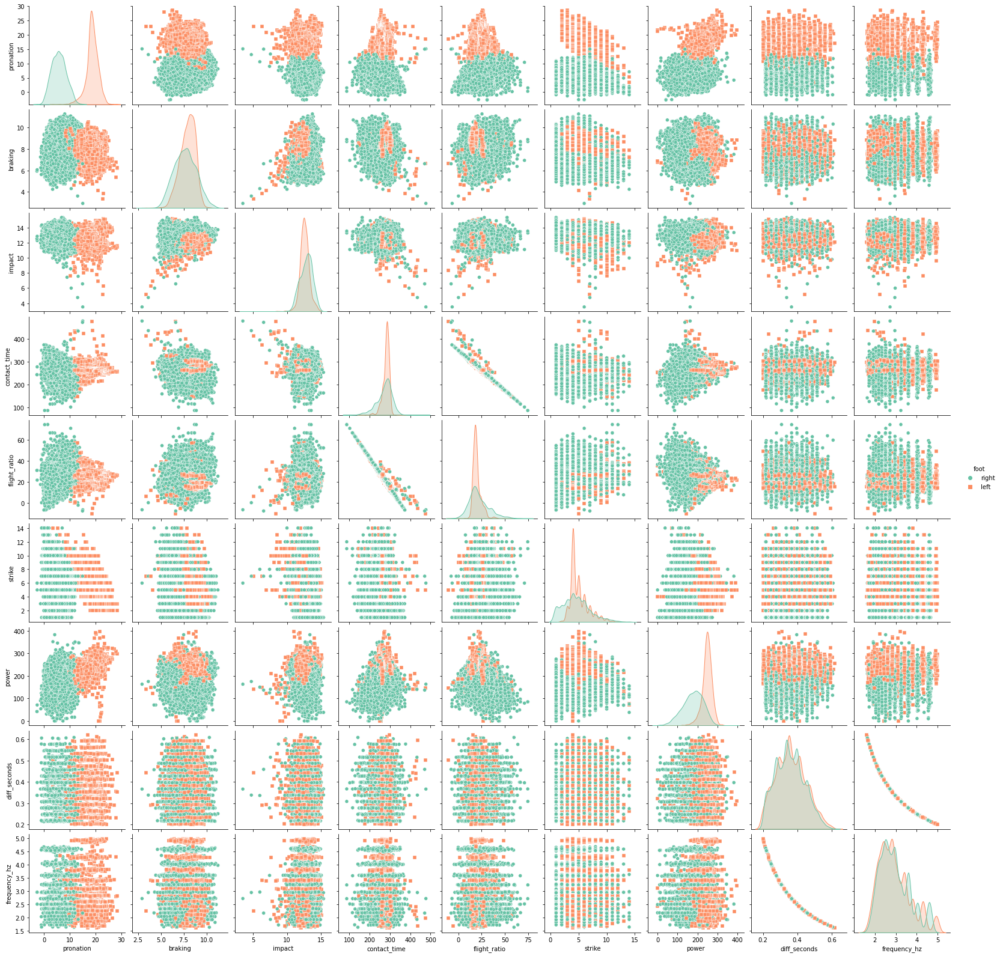

In [137]:
# left
sns.pairplot(filth_day1, kind="scatter", hue="foot", markers=["o", "s"], palette="Set2", )
plt.show()

In [138]:
filth_day1.groupby('foot').count()

,t,pronation,braking,impact,contact_time,flight_ratio,strike,power,diff_seconds,frequency_hz
foot,,,,,,,,,,
left,7003,7003,7003,7003,7003,7003,7003,7003,7003,7003
right,6708,6708,6708,6708,6708,6708,6708,6708,6708,6708
